## Importing dependencies

In [1]:
!pip install ultralytics -q

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 950.0/950.0 kB 24.5 MB/s eta 0:00:0000:01


In [2]:
import cv2
import numpy as np
import os
import matplotlib.pyplot as plt

import requests
from urllib.parse import urlencode

from ultralytics import YOLO

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


## Downloading data

In [3]:
base_url = 'https://cloud-api.yandex.net/v1/disk/public/resources/download?'
public_key = 'https://disk.yandex.ru/d/KpABINU3I8F0yQ'

final_url = base_url + urlencode(dict(public_key=public_key))
response = requests.get(final_url)
download_url = response.json()['href']

download_response = requests.get(download_url)
with open('dataset.zip', 'wb') as f:
    f.write(download_response.content)

In [4]:
!unzip -q dataset.zip
!rm dataset.zip

In [5]:
!mkdir datasets
!cp -r dataset datasets
!rm -rf dataset

## Checking markup correctness

In [6]:
def plot_polygons(image_path, label_path):
    image = cv2.imread(image_path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    h, w = image.shape[:2]
    
    with open(label_path, 'r') as f:
        for line in f.readlines():
            parts = list(map(float, line.strip().split()))
            class_id = int(parts[0])
            points = np.array(parts[1:], dtype=np.float32).reshape(-1, 2)
            
            points[:, 0] *= w
            points[:, 1] *= h
            points = points.astype(np.int32)
            
            cv2.polylines(image, [points], isClosed=True, color=(0, 255, 0), thickness=2)
    
    plt.figure(figsize=(10, 10))
    plt.imshow(image)
    plt.axis('off')
    plt.show()

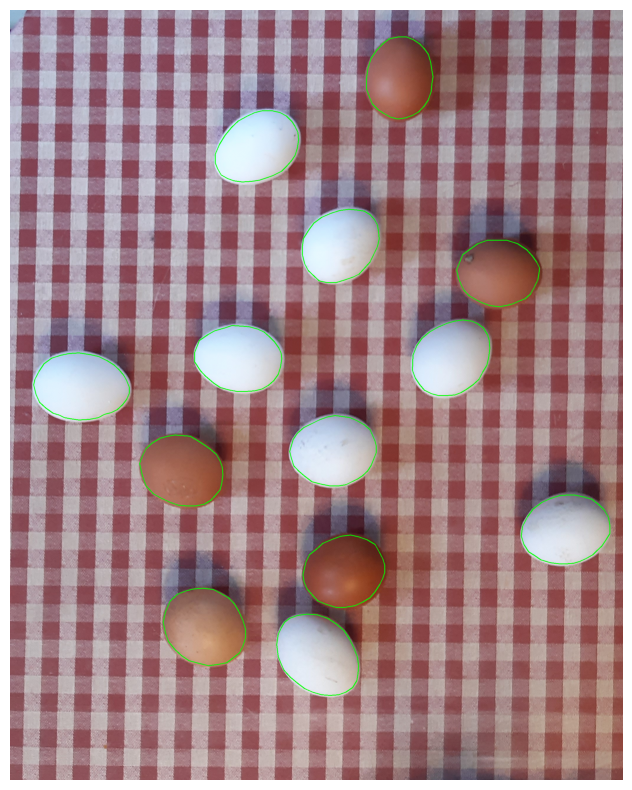

In [7]:
image_path = "datasets/dataset/val/images/62e4fac2-32.jpg"
label_path = "datasets/dataset/val/labels/62e4fac2-32.txt"
plot_polygons(image_path, label_path)

## Finetuning

In [8]:
model = YOLO('yolov8n-seg.pt')

100%|██████████| 6.74M/6.74M [00:00<00:00, 138MB/s]


In [9]:
model.train(
    data='dataset.yaml',
    epochs=100,
    imgsz=640,
    batch=8,
    augment=True,
    name='egg_segmentation'
)

Ultralytics 8.3.98 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla P100-PCIE-16GB, 16269MiB)
engine/trainer: task=segment, mode=train, model=yolov8n-seg.pt, data=dataset.yaml, epochs=100, time=None, patience=100, batch=8, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=egg_segmentation, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=True, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=Tru

100%|██████████| 755k/755k [00:00<00:00, 24.8MB/s]


Overriding model.yaml nc=80 with nc=1

                   from  n    params  module                                       arguments                     
  0                  -1  1       464  ultralytics.nn.modules.conv.Conv             [3, 16, 3, 2]                 
  1                  -1  1      4672  ultralytics.nn.modules.conv.Conv             [16, 32, 3, 2]                
  2                  -1  1      7360  ultralytics.nn.modules.block.C2f             [32, 32, 1, True]             
  3                  -1  1     18560  ultralytics.nn.modules.conv.Conv             [32, 64, 3, 2]                
  4                  -1  2     49664  ultralytics.nn.modules.block.C2f             [64, 64, 2, True]             
  5                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]               
  6                  -1  2    197632  ultralytics.nn.modules.block.C2f             [128, 128, 2, True]           
  7                  -1  1    295424  ultralytics

100%|██████████| 5.35M/5.35M [00:00<00:00, 121MB/s]


AMP: checks passed ✅


train: Scanning /kaggle/working/datasets/dataset/train/labels... 22 images, 0 backgrounds, 0 corrupt: 100%|██████████| 22/22 [00:00<00:00, 366.99it/s]

train: New cache created: /kaggle/working/datasets/dataset/train/labels.cache


albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


/usr/local/lib/python3.10/dist-packages/albumentations/__init__.py:24: UserWarning: A new version of Albumentations is available: 2.0.5 (you have 1.4.20). Upgrade using: pip install -U albumentations. To disable automatic update checks, set the environment variable NO_ALBUMENTATIONS_UPDATE to 1.
  check_for_updates()
val: Scanning /kaggle/working/datasets/dataset/val/labels... 4 images, 0 backgrounds, 0 corrupt: 100%|██████████| 4/4 [00:00<00:00, 263.82it/s]

val: New cache created: /kaggle/working/datasets/dataset/val/labels.cache


Plotting labels to runs/segment/egg_segmentation/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 66 weight(decay=0.0), 77 weight(decay=0.0005), 76 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 4 dataloader workers
Logging results to runs/segment/egg_segmentation
Starting training for 100 epochs...

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      1/100      1.97G      1.072      1.887      3.239      1.079        127        640: 100%|██████████| 3/3 [00:02<00:00,  1.00it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.79it/s]

                   all          4         62     0.0483      0.935     0.0556     0.0385     0.0492      0.952       0.06     0.0467



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      2/100      2.02G     0.8368      1.306      3.185     0.9803         82        640: 100%|██████████| 3/3 [00:00<00:00,  3.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 14.84it/s]

                   all          4         62     0.0517          1      0.117      0.103     0.0517          1      0.118      0.103



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      3/100      2.03G     0.5261     0.7598      2.673     0.8582        146        640: 100%|██████████| 3/3 [00:00<00:00,  5.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  9.10it/s]

                   all          4         62     0.0517          1      0.287      0.217     0.0517          1       0.32       0.25



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      4/100      2.04G     0.5278     0.6389       2.14     0.8348        131        640: 100%|██████████| 3/3 [00:00<00:00,  5.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 12.25it/s]

                   all          4         62     0.0517          1      0.752      0.563     0.0517          1      0.752      0.666



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      5/100      2.04G     0.5512     0.5431      1.623     0.8264        142        640: 100%|██████████| 3/3 [00:00<00:00,  6.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 13.50it/s]

                   all          4         62      0.945      0.839      0.936      0.758      0.945      0.839      0.936      0.834



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      6/100      2.04G     0.5041     0.5463      1.246     0.8229        139        640: 100%|██████████| 3/3 [00:00<00:00,  5.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 11.93it/s]

                   all          4         62      0.965        0.9      0.981      0.721      0.965        0.9      0.981      0.808



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      7/100      2.04G     0.5276      0.468     0.9665     0.8271        127        640: 100%|██████████| 3/3 [00:00<00:00,  5.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 11.03it/s]

                   all          4         62      0.947      0.935      0.984      0.785      0.947      0.935      0.984      0.838



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      8/100      2.04G     0.4752     0.4697     0.7983     0.8208        135        640: 100%|██████████| 3/3 [00:00<00:00,  5.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 12.02it/s]

                   all          4         62      0.966       0.93      0.988       0.78      0.966       0.93      0.988      0.859



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      9/100       2.1G     0.4902     0.4784     0.7156     0.8258        144        640: 100%|██████████| 3/3 [00:00<00:00,  5.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 12.33it/s]

                   all          4         62      0.934      0.906      0.978      0.781      0.934      0.906      0.978       0.81



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     10/100      2.14G     0.4875      0.473     0.7182     0.8233        124        640: 100%|██████████| 3/3 [00:00<00:00,  5.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 13.42it/s]

                   all          4         62      0.887      0.984      0.966      0.778      0.869      0.968      0.933      0.691



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     11/100      2.14G     0.4984     0.4074     0.7135     0.8231        132        640: 100%|██████████| 3/3 [00:00<00:00,  5.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 11.60it/s]

                   all          4         62      0.951          1      0.969      0.841      0.951          1      0.969       0.77



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     12/100      2.14G     0.4985     0.4864     0.6217     0.8373        128        640: 100%|██████████| 3/3 [00:00<00:00,  5.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 15.34it/s]

                   all          4         62       0.96          1      0.988      0.864       0.96          1      0.988      0.802



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     13/100      2.14G     0.4683     0.4501     0.6334     0.8328        125        640: 100%|██████████| 3/3 [00:00<00:00,  5.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 11.67it/s]

                   all          4         62      0.995          1      0.995      0.887      0.995          1      0.995      0.887



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     14/100      2.14G     0.4648     0.4102     0.6603     0.8317        158        640: 100%|██████████| 3/3 [00:00<00:00,  5.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 12.60it/s]

                   all          4         62      0.998          1      0.995      0.899      0.998          1      0.995      0.894



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     15/100      2.14G     0.4294     0.4598     0.6242     0.8245        109        640: 100%|██████████| 3/3 [00:00<00:00,  5.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 11.38it/s]

                   all          4         62      0.998          1      0.995      0.899      0.998          1      0.995      0.894



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     16/100      2.14G     0.4671     0.4491     0.6425     0.8219        140        640: 100%|██████████| 3/3 [00:00<00:00,  5.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 12.34it/s]

                   all          4         62      0.999          1      0.995      0.875      0.999          1      0.995      0.899



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     17/100      2.14G     0.4545     0.3933     0.5982      0.822        129        640: 100%|██████████| 3/3 [00:00<00:00,  5.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 11.60it/s]

                   all          4         62      0.999          1      0.995      0.886      0.999          1      0.995      0.898



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     18/100      2.14G     0.4554      0.398      0.593      0.821        121        640: 100%|██████████| 3/3 [00:00<00:00,  6.04it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  9.32it/s]

                   all          4         62      0.999          1      0.995      0.886      0.999          1      0.995      0.898



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     19/100      2.14G     0.4225     0.4227     0.5595     0.8168        141        640: 100%|██████████| 3/3 [00:00<00:00,  5.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 12.17it/s]

                   all          4         62      0.998          1      0.995      0.892      0.998          1      0.995      0.893



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     20/100      2.14G     0.4305     0.4166     0.5524     0.8179        151        640: 100%|██████████| 3/3 [00:00<00:00,  5.96it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 10.96it/s]

                   all          4         62      0.999          1      0.995      0.877      0.999          1      0.995      0.899



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     21/100      2.14G     0.4408      0.429     0.5876     0.8234        104        640: 100%|██████████| 3/3 [00:00<00:00,  6.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 12.16it/s]

                   all          4         62      0.999          1      0.995      0.877      0.999          1      0.995      0.899



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     22/100      2.14G     0.4494     0.4384     0.5635     0.8244        139        640: 100%|██████████| 3/3 [00:00<00:00,  5.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 11.55it/s]

                   all          4         62      0.999          1      0.995      0.884      0.999          1      0.995      0.911



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     23/100      2.14G     0.4552     0.3935     0.5573     0.8252        140        640: 100%|██████████| 3/3 [00:00<00:00,  6.39it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 11.36it/s]

                   all          4         62      0.999          1      0.995      0.884      0.999          1      0.995      0.911



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     24/100      2.14G     0.4525     0.4787     0.5727     0.8321        142        640: 100%|██████████| 3/3 [00:00<00:00,  6.01it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 12.57it/s]

                   all          4         62      0.999          1      0.995      0.911      0.999          1      0.995      0.872



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     25/100      2.14G     0.4902     0.5907     0.5448     0.8285        113        640: 100%|██████████| 3/3 [00:00<00:00,  6.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 11.65it/s]

                   all          4         62      0.999          1      0.995      0.911      0.999          1      0.995      0.872



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     26/100      2.14G     0.4792     0.5374      0.552     0.8199        166        640: 100%|██████████| 3/3 [00:00<00:00,  5.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 12.47it/s]

                   all          4         62      0.999          1      0.995      0.885      0.999          1      0.995      0.831



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     27/100      2.14G     0.4524     0.4586     0.5644     0.8158        109        640: 100%|██████████| 3/3 [00:00<00:00,  6.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 15.67it/s]

                   all          4         62      0.999          1      0.995      0.885      0.999          1      0.995      0.831



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     28/100      2.14G     0.4246     0.3929     0.5748     0.8264         68        640: 100%|██████████| 3/3 [00:00<00:00,  5.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 16.22it/s]

                   all          4         62      0.999          1      0.995      0.892      0.999          1      0.995        0.9



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     29/100      2.14G     0.5132     0.5551      0.588     0.8161        146        640: 100%|██████████| 3/3 [00:00<00:00,  5.98it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 15.54it/s]

                   all          4         62      0.999          1      0.995      0.892      0.999          1      0.995        0.9



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     30/100      2.14G     0.4167     0.4198     0.5511     0.8199        100        640: 100%|██████████| 3/3 [00:00<00:00,  6.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 12.79it/s]

                   all          4         62      0.999          1      0.995      0.892      0.999          1      0.995        0.9



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     31/100      2.14G     0.4585     0.5066     0.5811     0.8221        190        640: 100%|██████████| 3/3 [00:00<00:00,  5.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 11.97it/s]

                   all          4         62      0.999          1      0.995      0.917      0.999          1      0.995      0.899



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     32/100      2.14G     0.4129     0.4277     0.5413     0.8175        119        640: 100%|██████████| 3/3 [00:00<00:00,  5.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 12.14it/s]

                   all          4         62      0.999          1      0.995      0.917      0.999          1      0.995      0.899



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     33/100      2.14G     0.4495       0.44     0.5705     0.8196        164        640: 100%|██████████| 3/3 [00:00<00:00,  5.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 15.88it/s]

                   all          4         62      0.999          1      0.995      0.913      0.999          1      0.995      0.896



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     34/100      2.14G     0.4412     0.4229     0.5319     0.8235         99        640: 100%|██████████| 3/3 [00:00<00:00,  6.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 12.32it/s]

                   all          4         62      0.999          1      0.995      0.913      0.999          1      0.995      0.896



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     35/100      2.14G     0.4793     0.4414     0.5284     0.8185        112        640: 100%|██████████| 3/3 [00:00<00:00,  6.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  8.35it/s]

                   all          4         62      0.999          1      0.995      0.913      0.999          1      0.995      0.896



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     36/100      2.14G     0.4478     0.4638     0.5128     0.8157        145        640: 100%|██████████| 3/3 [00:00<00:00,  5.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  8.09it/s]

                   all          4         62      0.999          1      0.995      0.914      0.999          1      0.995      0.902



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     37/100      2.14G     0.4325      0.399     0.5216     0.8125        105        640: 100%|██████████| 3/3 [00:00<00:00,  5.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 11.98it/s]

                   all          4         62      0.999          1      0.995      0.914      0.999          1      0.995      0.902



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     38/100      2.14G     0.4315     0.4272     0.5262     0.8268        141        640: 100%|██████████| 3/3 [00:00<00:00,  6.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 15.58it/s]

                   all          4         62      0.999          1      0.995      0.914      0.999          1      0.995      0.902



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     39/100      2.14G     0.4272     0.4015     0.5043     0.8178        115        640: 100%|██████████| 3/3 [00:00<00:00,  5.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 15.46it/s]

                   all          4         62      0.999          1      0.995      0.891      0.999          1      0.995      0.912



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     40/100      2.14G     0.4201     0.4043     0.4779     0.8183        147        640: 100%|██████████| 3/3 [00:00<00:00,  5.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 11.96it/s]

                   all          4         62      0.999          1      0.995      0.891      0.999          1      0.995      0.912



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     41/100      2.14G     0.4075     0.4043     0.4978     0.8318        112        640: 100%|██████████| 3/3 [00:00<00:00,  5.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 12.52it/s]

                   all          4         62      0.999          1      0.995      0.915      0.999          1      0.995      0.918



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     42/100      2.14G     0.4103     0.3885     0.4857     0.8187        128        640: 100%|██████████| 3/3 [00:00<00:00,  6.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 12.05it/s]

                   all          4         62      0.999          1      0.995      0.915      0.999          1      0.995      0.918



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     43/100      2.14G     0.4032     0.3712     0.4842     0.8054        108        640: 100%|██████████| 3/3 [00:00<00:00,  6.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 10.62it/s]

                   all          4         62      0.999          1      0.995      0.915      0.999          1      0.995      0.918



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     44/100      2.14G     0.4134     0.3912     0.4893     0.8176        160        640: 100%|██████████| 3/3 [00:00<00:00,  5.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 12.13it/s]

                   all          4         62      0.999          1      0.995      0.917      0.999          1      0.995      0.885



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     45/100      2.14G     0.3953     0.3987     0.5132     0.8105         67        640: 100%|██████████| 3/3 [00:00<00:00,  6.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 12.25it/s]

                   all          4         62      0.999          1      0.995      0.917      0.999          1      0.995      0.885



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     46/100      2.14G     0.4131     0.4101     0.5067     0.8258        119        640: 100%|██████████| 3/3 [00:00<00:00,  6.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 12.17it/s]

                   all          4         62      0.999          1      0.995      0.917      0.999          1      0.995      0.885



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     47/100      2.14G     0.3822     0.3598     0.4785      0.823        124        640: 100%|██████████| 3/3 [00:00<00:00,  6.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 11.84it/s]

                   all          4         62      0.999          1      0.995      0.938      0.999          1      0.995      0.901



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     48/100      2.14G     0.3754     0.3853     0.4897     0.8159        110        640: 100%|██████████| 3/3 [00:00<00:00,  6.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 12.45it/s]

                   all          4         62      0.999          1      0.995      0.938      0.999          1      0.995      0.901



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     49/100       2.2G     0.3624     0.3797     0.5076     0.8205         90        640: 100%|██████████| 3/3 [00:00<00:00,  5.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 13.46it/s]

                   all          4         62      0.999          1      0.995      0.922      0.999          1      0.995      0.914



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     50/100       2.2G     0.3554     0.3491     0.4536     0.8162        130        640: 100%|██████████| 3/3 [00:00<00:00,  6.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 12.30it/s]

                   all          4         62      0.999          1      0.995      0.922      0.999          1      0.995      0.914



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     51/100       2.2G     0.3797     0.3609     0.4768     0.8137        176        640: 100%|██████████| 3/3 [00:00<00:00,  6.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 11.38it/s]

                   all          4         62      0.999          1      0.995      0.922      0.999          1      0.995      0.914



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     52/100       2.2G     0.4039     0.3844     0.4799     0.8188         96        640: 100%|██████████| 3/3 [00:00<00:00,  5.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 11.04it/s]

                   all          4         62      0.999          1      0.995      0.929      0.999          1      0.995      0.919



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     53/100       2.2G     0.3727     0.3755     0.4659     0.8073        176        640: 100%|██████████| 3/3 [00:00<00:00,  6.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 12.15it/s]

                   all          4         62      0.999          1      0.995      0.929      0.999          1      0.995      0.919



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     54/100       2.2G     0.3592     0.3841     0.4522     0.8091        109        640: 100%|██████████| 3/3 [00:00<00:00,  6.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 14.37it/s]

                   all          4         62      0.999          1      0.995      0.929      0.999          1      0.995      0.919



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     55/100       2.2G     0.3773     0.3624     0.4539     0.8082        111        640: 100%|██████████| 3/3 [00:00<00:00,  5.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 12.16it/s]

                   all          4         62      0.999          1      0.995      0.944      0.999          1      0.995      0.918



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     56/100       2.2G     0.3764     0.3914     0.4672     0.8062        107        640: 100%|██████████| 3/3 [00:00<00:00,  5.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 11.69it/s]

                   all          4         62      0.999          1      0.995      0.944      0.999          1      0.995      0.918



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     57/100       2.2G     0.3646     0.3796     0.4557     0.8178        128        640: 100%|██████████| 3/3 [00:00<00:00,  5.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 11.36it/s]

                   all          4         62      0.999          1      0.995      0.946      0.999          1      0.995      0.916



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     58/100       2.2G     0.3328     0.3164     0.4353     0.8068        113        640: 100%|██████████| 3/3 [00:00<00:00,  6.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 12.27it/s]

                   all          4         62      0.999          1      0.995      0.946      0.999          1      0.995      0.916



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     59/100       2.2G     0.3687     0.3615     0.4617     0.8017        143        640: 100%|██████████| 3/3 [00:00<00:00,  6.04it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 12.31it/s]

                   all          4         62      0.999          1      0.995      0.946      0.999          1      0.995      0.916



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     60/100       2.2G     0.3419     0.3761     0.4396     0.8029        125        640: 100%|██████████| 3/3 [00:00<00:00,  5.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 12.15it/s]

                   all          4         62      0.999          1      0.995      0.926      0.999          1      0.995      0.929



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     61/100       2.2G     0.3667     0.3833     0.4722     0.8245         77        640: 100%|██████████| 3/3 [00:00<00:00,  5.96it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 11.89it/s]

                   all          4         62      0.999          1      0.995      0.926      0.999          1      0.995      0.929



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     62/100       2.2G     0.3416     0.3341     0.4303     0.8155        118        640: 100%|██████████| 3/3 [00:00<00:00,  5.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 12.78it/s]

                   all          4         62      0.999          1      0.995      0.926      0.999          1      0.995      0.929



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     63/100       2.2G     0.3446     0.3441     0.4574     0.8118         86        640: 100%|██████████| 3/3 [00:00<00:00,  5.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 12.61it/s]

                   all          4         62      0.999          1      0.995      0.945      0.999          1      0.995      0.924



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     64/100       2.2G     0.3571     0.3575      0.452     0.8082        179        640: 100%|██████████| 3/3 [00:00<00:00,  5.98it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 15.55it/s]

                   all          4         62      0.999          1      0.995      0.945      0.999          1      0.995      0.924



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     65/100       2.2G     0.3515     0.3634     0.4275     0.8102        155        640: 100%|██████████| 3/3 [00:00<00:00,  5.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 15.20it/s]

                   all          4         62      0.999          1      0.995      0.963      0.999          1      0.995       0.92



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     66/100       2.2G     0.3546     0.3272     0.4258     0.8042        107        640: 100%|██████████| 3/3 [00:00<00:00,  5.96it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 13.60it/s]

                   all          4         62      0.999          1      0.995      0.963      0.999          1      0.995       0.92



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     67/100       2.2G     0.3571     0.3446      0.431      0.799        140        640: 100%|██████████| 3/3 [00:00<00:00,  6.00it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 15.56it/s]

                   all          4         62      0.999          1      0.995      0.963      0.999          1      0.995       0.92



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     68/100       2.2G     0.3916      0.376     0.4561     0.7976         84        640: 100%|██████████| 3/3 [00:00<00:00,  5.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 11.90it/s]

                   all          4         62      0.999          1      0.995      0.956      0.999          1      0.995      0.924



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     69/100       2.2G     0.3675     0.3298     0.4195     0.8023        154        640: 100%|██████████| 3/3 [00:00<00:00,  6.00it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 11.14it/s]

                   all          4         62      0.999          1      0.995      0.956      0.999          1      0.995      0.924



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     70/100       2.2G     0.3444     0.3252     0.4364     0.8007        151        640: 100%|██████████| 3/3 [00:00<00:00,  6.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 12.64it/s]

                   all          4         62      0.999          1      0.995      0.956      0.999          1      0.995      0.924



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     71/100       2.2G     0.3223     0.3142     0.4289      0.806        107        640: 100%|██████████| 3/3 [00:00<00:00,  5.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 12.16it/s]

                   all          4         62      0.999          1      0.995      0.955      0.999          1      0.995      0.921



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     72/100       2.2G     0.3018     0.2891     0.4172     0.8026        116        640: 100%|██████████| 3/3 [00:00<00:00,  5.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  7.99it/s]

                   all          4         62      0.999          1      0.995      0.955      0.999          1      0.995      0.921



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     73/100       2.2G     0.3525     0.3811     0.4261     0.8058        141        640: 100%|██████████| 3/3 [00:00<00:00,  5.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 15.39it/s]

                   all          4         62      0.999          1      0.995      0.946      0.999          1      0.995       0.92



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     74/100       2.2G     0.3482     0.2979      0.404     0.8089        126        640: 100%|██████████| 3/3 [00:00<00:00,  6.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 11.22it/s]

                   all          4         62      0.999          1      0.995      0.946      0.999          1      0.995       0.92



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     75/100       2.2G     0.3378     0.3467     0.4219      0.808        133        640: 100%|██████████| 3/3 [00:00<00:00,  5.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 12.47it/s]

                   all          4         62      0.999          1      0.995      0.946      0.999          1      0.995       0.92



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     76/100       2.2G     0.3411     0.3341      0.411     0.8017        138        640: 100%|██████████| 3/3 [00:00<00:00,  5.95it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 13.63it/s]

                   all          4         62      0.999          1      0.995      0.952      0.999          1      0.995      0.918



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     77/100       2.2G     0.3221     0.3516     0.4018     0.8101        140        640: 100%|██████████| 3/3 [00:00<00:00,  5.96it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 11.66it/s]

                   all          4         62      0.999          1      0.995      0.952      0.999          1      0.995      0.918



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     78/100       2.2G      0.347     0.3799     0.4122     0.7995        140        640: 100%|██████████| 3/3 [00:00<00:00,  5.95it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 11.82it/s]

                   all          4         62      0.999          1      0.995      0.952      0.999          1      0.995      0.918



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     79/100       2.2G     0.3357     0.3524     0.4121     0.7843        145        640: 100%|██████████| 3/3 [00:00<00:00,  5.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 12.07it/s]

                   all          4         62      0.999          1      0.995       0.96      0.999          1      0.995      0.919



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     80/100       2.2G     0.3274     0.3523     0.4158     0.8051        104        640: 100%|██████████| 3/3 [00:00<00:00,  6.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 12.23it/s]

                   all          4         62      0.999          1      0.995       0.96      0.999          1      0.995      0.919



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     81/100       2.2G     0.3308     0.3051     0.3955      0.801        110        640: 100%|██████████| 3/3 [00:00<00:00,  5.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 14.72it/s]

                   all          4         62      0.999          1      0.995      0.972      0.999          1      0.995      0.926



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     82/100       2.2G      0.335      0.334     0.4004     0.8027        131        640: 100%|██████████| 3/3 [00:00<00:00,  6.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 12.33it/s]

                   all          4         62      0.999          1      0.995      0.972      0.999          1      0.995      0.926



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     83/100       2.2G      0.338     0.3365     0.4083     0.7997        165        640: 100%|██████████| 3/3 [00:00<00:00,  6.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 15.49it/s]

                   all          4         62      0.999          1      0.995      0.972      0.999          1      0.995      0.926



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     84/100       2.2G     0.3107     0.3188     0.4208     0.8152        192        640: 100%|██████████| 3/3 [00:00<00:00,  5.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 15.11it/s]

                   all          4         62      0.999          1      0.995      0.964      0.999          1      0.995      0.935



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     85/100       2.2G      0.314     0.3334     0.3953     0.8129        107        640: 100%|██████████| 3/3 [00:00<00:00,  5.95it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 12.33it/s]

                   all          4         62      0.999          1      0.995      0.964      0.999          1      0.995      0.935



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     86/100       2.2G     0.3122     0.3237     0.4026     0.8015        113        640: 100%|██████████| 3/3 [00:00<00:00,  6.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 10.81it/s]

                   all          4         62      0.999          1      0.995      0.964      0.999          1      0.995      0.935



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     87/100       2.2G     0.3226     0.3314      0.383     0.8076        109        640: 100%|██████████| 3/3 [00:00<00:00,  6.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 11.47it/s]

                   all          4         62      0.999          1      0.995      0.964      0.999          1      0.995      0.935



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     88/100       2.2G     0.3086     0.3085     0.4009     0.8071        124        640: 100%|██████████| 3/3 [00:00<00:00,  6.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 15.78it/s]

                   all          4         62      0.999          1      0.995      0.964      0.999          1      0.995      0.935



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     89/100       2.2G     0.3297     0.3324     0.3919     0.8023        116        640: 100%|██████████| 3/3 [00:00<00:00,  6.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 10.87it/s]

                   all          4         62      0.999          1      0.995       0.96      0.999          1      0.995      0.937



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     90/100       2.2G     0.3084     0.3099     0.3812     0.8036        122        640: 100%|██████████| 3/3 [00:00<00:00,  6.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 15.42it/s]

                   all          4         62      0.999          1      0.995       0.96      0.999          1      0.995      0.937


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     91/100       2.2G     0.2699     0.3003     0.3982      0.781         78        640: 100%|██████████| 3/3 [00:01<00:00,  1.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.28it/s]

                   all          4         62      0.999          1      0.995       0.96      0.999          1      0.995      0.937



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     92/100       2.2G     0.2776     0.3002     0.3934     0.7824         77        640: 100%|██████████| 3/3 [00:00<00:00,  6.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 12.13it/s]

                   all          4         62      0.999          1      0.995      0.962      0.999          1      0.995       0.93



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     93/100       2.2G     0.2747     0.3217     0.4081        0.8         77        640: 100%|██████████| 3/3 [00:00<00:00,  6.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 11.81it/s]

                   all          4         62      0.999          1      0.995      0.962      0.999          1      0.995       0.93



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     94/100       2.2G     0.2805     0.3075     0.4031     0.7785         88        640: 100%|██████████| 3/3 [00:00<00:00,  5.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 10.40it/s]

                   all          4         62      0.999          1      0.995      0.962      0.999          1      0.995       0.93



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     95/100       2.2G     0.2996     0.3255     0.4234     0.7819         79        640: 100%|██████████| 3/3 [00:00<00:00,  6.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 11.85it/s]

                   all          4         62      0.999          1      0.995      0.962      0.999          1      0.995      0.926



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     96/100       2.2G     0.2631     0.3322     0.4122     0.7909         69        640: 100%|██████████| 3/3 [00:00<00:00,  6.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 15.70it/s]

                   all          4         62      0.999          1      0.995      0.962      0.999          1      0.995      0.926



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     97/100       2.2G     0.2832     0.2846     0.4105     0.7875         76        640: 100%|██████████| 3/3 [00:00<00:00,  6.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 11.99it/s]

                   all          4         62      0.999          1      0.995      0.962      0.999          1      0.995      0.924



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     98/100       2.2G      0.244     0.2884     0.3627     0.7715         85        640: 100%|██████████| 3/3 [00:00<00:00,  6.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 15.14it/s]

                   all          4         62      0.999          1      0.995      0.962      0.999          1      0.995      0.924



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     99/100       2.2G     0.2583     0.2912     0.4049     0.7785         79        640: 100%|██████████| 3/3 [00:00<00:00,  6.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 15.84it/s]

                   all          4         62      0.999          1      0.995      0.962      0.999          1      0.995      0.924



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


    100/100       2.2G     0.2558     0.2971     0.3736     0.7743         74        640: 100%|██████████| 3/3 [00:00<00:00,  6.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 15.99it/s]

                   all          4         62      0.999          1      0.995      0.962      0.999          1      0.995      0.926



100 epochs completed in 0.027 hours.
Optimizer stripped from runs/segment/egg_segmentation/weights/last.pt, 6.8MB
Optimizer stripped from runs/segment/egg_segmentation/weights/best.pt, 6.8MB

Validating runs/segment/egg_segmentation/weights/best.pt...
Ultralytics 8.3.98 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla P100-PCIE-16GB, 16269MiB)
YOLOv8n-seg summary (fused): 85 layers, 3,258,259 parameters, 0 gradients, 12.0 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95):   0%|          | 0/1 [00:00<?, ?it/s]

WARNING ⚠️ Model does not support 'augment=True', reverting to single-scale prediction.
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 11.82it/s]


                   all          4         62      0.999          1      0.995      0.964      0.999          1      0.995      0.935


/usr/local/lib/python3.10/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1
/usr/local/lib/python3.10/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1


Speed: 0.2ms preprocess, 4.2ms inference, 0.0ms loss, 1.6ms postprocess per image
Results saved to runs/segment/egg_segmentation


ultralytics.utils.metrics.SegmentMetrics object with attributes:

ap_class_index: array([0])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7bbd182f1090>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)', 'Precision-Recall(M)', 'F1-Confidence(M)', 'Precision-Confidence(M)', 'Recall-Confidence(M)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041, 

## Visualizing predictions


WARNING ⚠️ Model does not support 'augment=True', reverting to single-scale prediction.
image 1/1 /kaggle/working/datasets/dataset/val/images/75c79d33-41.jpg: 640x416 16 eggs, 43.8ms
Speed: 3.3ms preprocess, 43.8ms inference, 11.3ms postprocess per image at shape (1, 3, 640, 416)


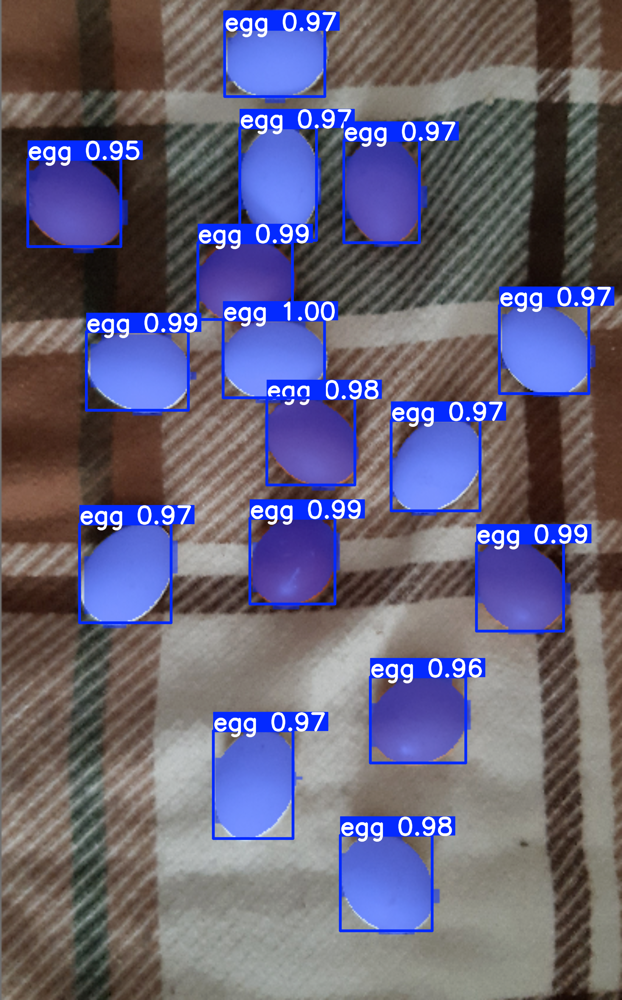

In [10]:
results = model.predict('datasets/dataset/val/images/75c79d33-41.jpg')
results[0].show()

In [11]:
len(results[0].masks)

16

In [12]:
# saving best model
model.save('best_model.pt')

## Constructing API

In [13]:
from ultralytics import YOLO
import cv2
import numpy as np
from typing import Tuple, Dict

from google.colab.patches import cv2_imshow

In [22]:
config = {
    'model_path': 'best_model.pt',
    'brightness_threshold': 170,
    'conf_threshold': 0.5
}

In [15]:
def load_model(config: Dict) -> YOLO:
    model_path = config['model_path']
    model = YOLO(model_path)
    return model

In [16]:
def process_eggs(
    config: Dict,
    model: YOLO, 
    image: np.ndarray
) -> Tuple[np.ndarray, int, int]:
    
    brightness_threshold = config['brightness_threshold']
    conf_threshold = config['conf_threshold']
    
    rgb_image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    orig_h, orig_w = rgb_image.shape[:2]
    
    results = model.predict(rgb_image, conf=conf_threshold, verbose=False)
    
    white_count = 0
    dark_count = 0
    
    annotated_img = rgb_image.copy()
    
    if results[0].masks is not None:
        for i, mask in enumerate(results[0].masks):
            bin_mask = mask.data[0].cpu().numpy()
            bin_mask = (bin_mask * 255).astype(np.uint8)
            bin_mask = cv2.resize(bin_mask, (orig_w, orig_h))
            
            masked_region = cv2.bitwise_and(rgb_image, rgb_image, mask=bin_mask)
            mean_brightness = np.mean(masked_region[bin_mask == 255])
            
            if mean_brightness > brightness_threshold:
                white_count += 1
                color = (0, 255, 0)
            else:
                dark_count += 1
                color = (0, 0, 255)
            
            x1, y1, x2, y2 = map(int, results[0].boxes[i].xyxy[0].cpu().numpy())
            
            points = mask.xy[0].astype(np.int32)
            cv2.polylines(annotated_img, [points], True, color, 2)
            
            cv2.putText(
                annotated_img,
                f"{'White' if mean_brightness > brightness_threshold else 'Dark'}",
                (x1, y1 - 10),
                cv2.FONT_HERSHEY_SIMPLEX,
                0.7,
                color,
                2
            )
    
    annotated_img_bgr = cv2.cvtColor(annotated_img, cv2.COLOR_RGB2BGR)
    
    return annotated_img_bgr, white_count, dark_count

## Checking API

In [23]:
model = load_model(config)

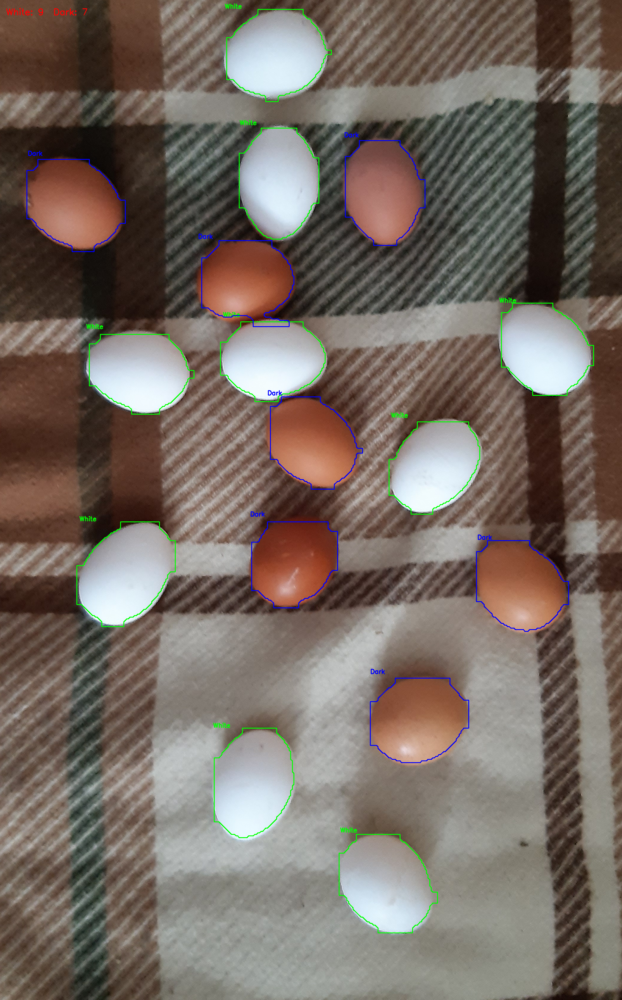

In [28]:
image = cv2.imread('datasets/dataset/val/images/75c79d33-41.jpg')

result_img, white, dark = process_eggs(config, model, image)

cv2.putText(result_img, 
           f"White: {white}  Dark: {dark}",
           (20, 50), 
           cv2.FONT_HERSHEY_SIMPLEX, 
           1, 
           (0, 0, 255), 
           2)

cv2_imshow(result_img)

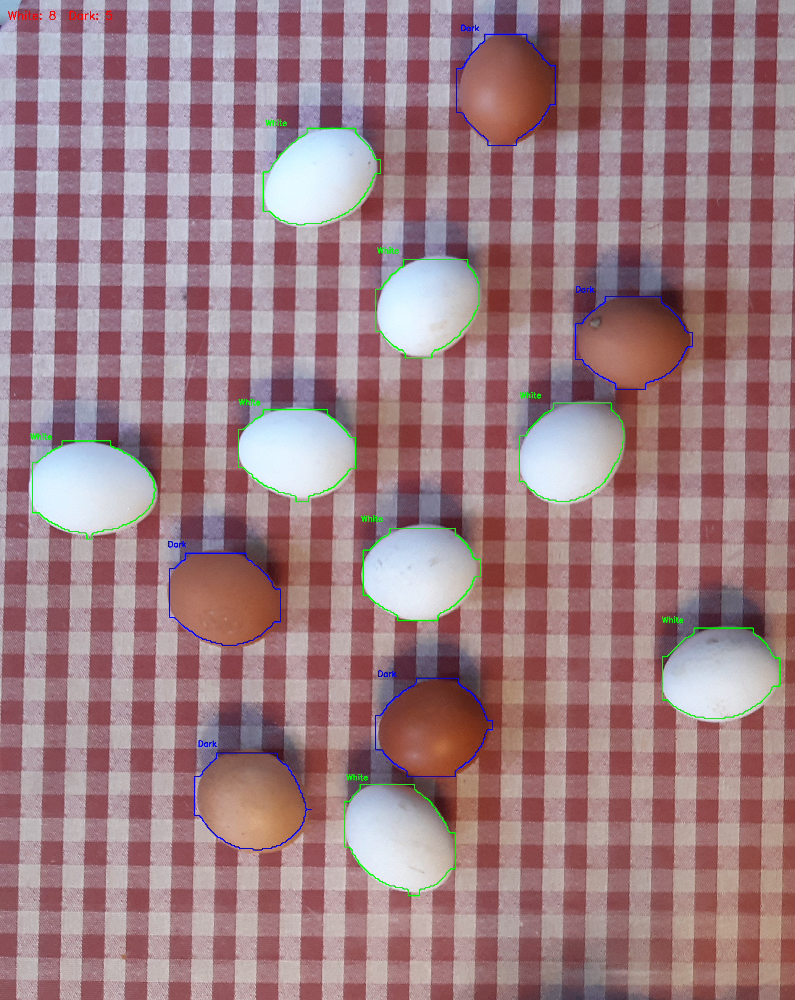

In [29]:
image = cv2.imread('datasets/dataset/val/images/62e4fac2-32.jpg')

result_img, white, dark = process_eggs(config, model, image)

cv2.putText(result_img, 
           f"White: {white}  Dark: {dark}",
           (20, 50), 
           cv2.FONT_HERSHEY_SIMPLEX, 
           1, 
           (0, 0, 255), 
           2)

cv2_imshow(result_img)

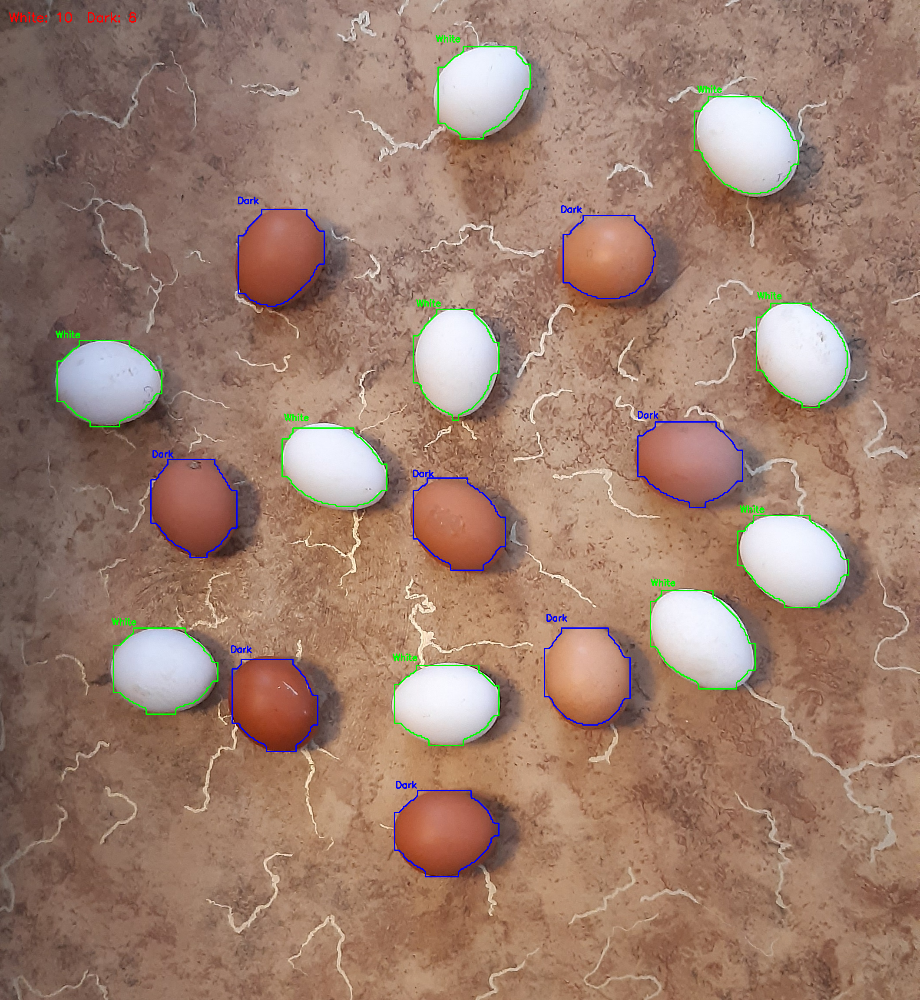

In [30]:
image = cv2.imread('datasets/dataset/val/images/79c30ef6-21.jpg')

result_img, white, dark = process_eggs(config, model, image)

cv2.putText(result_img, 
           f"White: {white}  Dark: {dark}",
           (20, 50), 
           cv2.FONT_HERSHEY_SIMPLEX, 
           1, 
           (0, 0, 255), 
           2)

cv2_imshow(result_img)

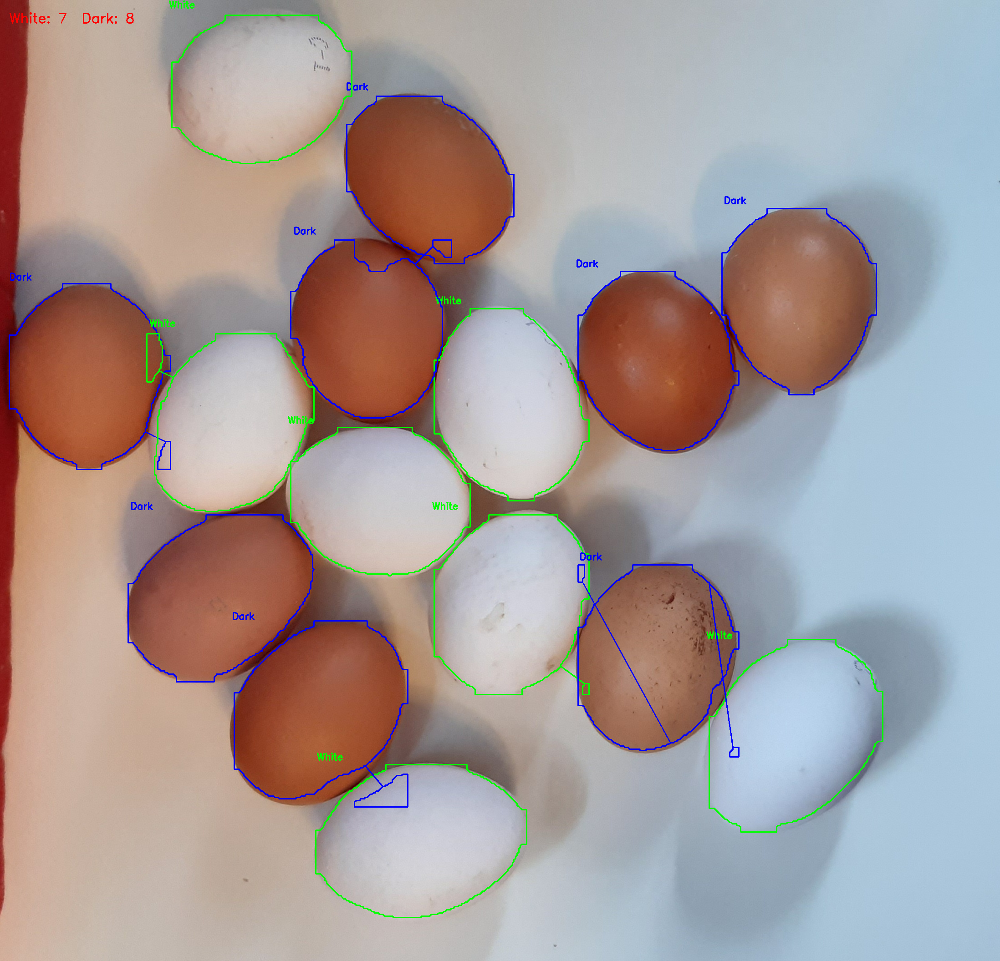

In [31]:
image = cv2.imread('/kaggle/working/datasets/dataset/val/images/ea3deddd-01.jpg')

result_img, white, dark = process_eggs(config, model, image)

cv2.putText(result_img, 
           f"White: {white}  Dark: {dark}",
           (20, 50), 
           cv2.FONT_HERSHEY_SIMPLEX, 
           1, 
           (0, 0, 255), 
           2)

cv2_imshow(result_img)